# ELG7186 - Winter 2022 - Assignment 2
## Due: <strong>Monday February 28<sup>th</sup> 2022 -- 11:59pm</strong>

The purpose of this assignment is to gain experience building and training neural networks. You will learn:
- Design and train a fully-connected neural network
- Train an existing CNN architecture using fine-tuning
- Visualize the trained model


### Submission Details
Submit your Jupyter notebook .ipynb file using Brightspace. Do not include any other files or images as they will not be reviewed.
<p>
<strong>Make certain that you run all the cells in the notebook you submit</strong> or you will loose marks.
</p>
<ul>
<li>You can submit multiple times, but only the most recent submission will be saved</li>
<li>Do not wait until the last minute to submit in case you have an unexpected issue</li>
<li>Review the late policy in the syllabus</li>
<li><strong>You must submit your own work</strong> and abide by the University of Ottawa policy on plagiarism and fraud</li>
</ul>


### DO NOT submit any images from the dataset

## Part 0. Data Preparation

To complete the assignment you will download the Caltech Bird dataset and devise an appropriate training set split. <b>You are free to sample from the dataset to reduce the overal training samples depending on your access to compute.</b> Again, the overall accuracy is less important than your  observations and comparisons.

Dataset: <a href="http://www.vision.caltech.edu/visipedia/CUB-200-2011.html">Caltech-UCSD Birds-200-2011</a> (Also posed on Brightspace)

The dataset contains annotations for various tasks. In this assignment you will use the categories for classification (species labels)

In this section:
<ul>
<li>Download the dataset as described above</li>
<li>Create your splits for your dataset (there is a split provided for the full dataset) </li>
<li>Visualize five samples of each class by plotting a grid using the matplotlib library.</li>
</ul>


In [1]:
# Prepare your dataset here and display samples here.
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
from skimage.transform import rescale, resize
from skimage.io import imread
import random


In [2]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [3]:
#/content/drive/MyDrive/CUB_200_2011.tgz

!tar -xzvf "/content/drive/MyDrive/CUB_200_2011.tgz" -C "/content/drive/MyDrive/images_dataset"  

Streaming output truncated to the last 5000 lines.
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0050_111087.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0079_113288.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0004_111989.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0068_113247.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0127_111935.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0094_112773.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0028_113217.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0126_110959.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0007_111029.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0096_111519.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0120_113001.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0010_112678.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0025_111669.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0084_111300.j

In [4]:
# the paths to match the location of the CUB dataset
#/content/drive/MyDrive/images_dataset
#/content/drive/MyDrive/images_dataset/CUB_200_2011
path = "/content/drive/MyDrive/images_dataset/CUB_200_2011/"
cub_dataset_dir = "images/"
file1 =path+'images.txt'
file1 = open(file1,'r')
imdir = file1.read()
imdir = imdir.split()
imdir = imdir[1::2]
for i in range(len(imdir)):
    imdir[i] =path + cub_dataset_dir+imdir[i]
file1 = open(path + 'image_class_labels.txt','r')
y = file1.read()
y = y.split()
y = y[1::2]

imdir[:5]


['/content/drive/MyDrive/images_dataset/CUB_200_2011/images/001.Black_footed_Albatross/Black_Footed_Albatross_0046_18.jpg',
 '/content/drive/MyDrive/images_dataset/CUB_200_2011/images/001.Black_footed_Albatross/Black_Footed_Albatross_0009_34.jpg',
 '/content/drive/MyDrive/images_dataset/CUB_200_2011/images/001.Black_footed_Albatross/Black_Footed_Albatross_0002_55.jpg',
 '/content/drive/MyDrive/images_dataset/CUB_200_2011/images/001.Black_footed_Albatross/Black_Footed_Albatross_0074_59.jpg',
 '/content/drive/MyDrive/images_dataset/CUB_200_2011/images/001.Black_footed_Albatross/Black_Footed_Albatross_0014_89.jpg']

In [5]:
for i in range(len(y)):
    y[i] = int(y[i]) -1
images =[]
for image in imdir:
    images.append(imread(image))

#### represent images and some operation 

In [5]:
def plot_image(image):
    plt.imshow(image, cmap="gray", interpolation="nearest")
    plt.axis("off")

def plot_color_image(image):
    plt.imshow(image.astype(np.uint8),interpolation="nearest")
    plt.axis("off")

In [ ]:
def show_images(images, y ,row ,collum):
  fig , ax = plt.subplots(200, 5 ,figsize=(row,collum))
  a = np.array(y)
  number ={}
  for i in range(200):
      number[i] = np.where(a ==i)[0][:5]
      for j in range(5):
          plt.axis("off")
          ax[i,j].imshow(images[number[i][j]], cmap = matplotlib.cm.binary)



(350, 350, 3)

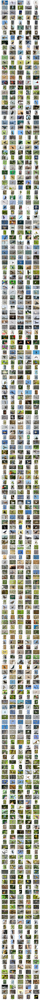

In [ ]:
show_images(images,y,15,400)
images[10].shape

### train test splet data and store in data frame 

In [6]:

#reed test data and train data  from text file 
f_train_test = open(path+'train_test_split.txt','r')
train_test_split = f_train_test.read()
train_test_split= train_test_split.split()
train_test_split = train_test_split[1::2]
for i in range(len(train_test_split)):
    train_test_split[i] = int(train_test_split[i])
#train_test_split

In [7]:
# devide test and train data 
c = np.array(train_test_split)
train_index = np.where(c == 1)
test_index = np.where(c == 0)
train =[]
test=[]

for i in train_index[0]:
    train.append([images[i],y[i]])
train_data= pd.DataFrame(train, columns = ['x', 'y'])
                       
for i in test_index[0]:
    test.append([images[i],y[i]])
test_data = pd.DataFrame(test, columns = ['x', 'y'])

print("train data shape: ", train_data.shape , "\ntest data length: ",len(test_data))

train data shape:  (5994, 2) 
test data length:  5794


## Part 1. Perceptron (3 Marks)
For this section you will implement a fully connected neural network (multi-layer perceptron). To do this you will need to perform the following steps:
- Resize the images to be no larger than 32x32.
- Use the sequential model API in keras to build your network using dense layers (consider performance impacts of fully connected layers)
- You must decide an appropriate number of neurons and layers.
- Print a summary of your model configuration. 


When your classifier is working:
- Plot a loss curve for training and test data
- Plot an accuracy curve for training and test data
- Provide a brief discussion of your results 


In [8]:

# Write your FC network code here
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D
from sklearn.metrics import accuracy_score
from tensorflow.keras.utils import to_categorical


### rescaling data to be in 0:1

In [9]:
# resuze image to every size 
def resize_images(train_data ,test_data ,size):
  resize_train = []
  resize_test = []
  y_train =[]
  y_test=[]
  for i in range(len(train_data['x'])):
      if len(train_data['x'][i].shape) == 3 :
          tf_im = tf.image.resize(train_data['x'][i], size, method='nearest')
          resize_train.append(tf_im.numpy()/255.0)
          y_train.append(train_data['y'][i])
  for i in range(len(test_data['x'])):
      if len(test_data['x'][i].shape) == 3 :
          tf_im = tf.image.resize(test_data['x'][i],size, method='nearest')
          resize_test.append(tf_im.numpy()/255.0)
          y_test.append(train_data['y'][i])
  resize_train =np.asarray(resize_train)
  resize_test =np.asarray(resize_test)
  return (resize_train,y_train ,resize_test,y_test)
  
def reshape_images(train ,test):
  v =train.shape[1]*train.shape[2]*train.shape[3]
  X_train= train.reshape(train.shape[0] , v)
  X_test = test.reshape(test.shape[0] , v )
  return X_train ,X_test


### normalize images and resizeing

In [10]:

resize_train,y_train ,resize_test,y_test = resize_images(train_data ,test_data ,(32,32))
x_tr ,x_te = reshape_images(resize_train ,resize_test)
y_tr_categ = to_categorical(y_train,200)
y_te_categ = to_categorical(y_test,200)
y_tr_categ.shape


(5990, 200)

### MLP Classifier building 

In [12]:
# get input dimension 32x32 pixels
input_dim = (x_tr.shape[1],)
# get output dimensions 200 classes
output_dim = len(np.unique(y_train))

# create sequential model
MLP_clf = keras.Sequential()
MLP_clf.add(Dense(units=128 ,input_shape=input_dim ,activation='relu'))
MLP_clf.add(Dense(units=128, activation='relu'))
MLP_clf.add(Dense(units=128, activation='relu'))
MLP_clf.add(Dense(units=output_dim, activation='softmax'))
MLP_clf.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 128)               393344    
                                                                 
 dense_1 (Dense)             (None, 128)               16512     
                                                                 
 dense_2 (Dense)             (None, 128)               16512     
                                                                 
 dense_3 (Dense)             (None, 200)               25800     
                                                                 
Total params: 452,168
Trainable params: 452,168
Non-trainable params: 0
_________________________________________________________________


In [13]:
# compile the model and give his mitrics 
MLP_clf.compile(optimizer='adam',
                loss='categorical_crossentropy',
                metrics=['accuracy'])
# fit the model 
MLP_results =MLP_clf.fit(x_tr, y_tr_categ, 
                         epochs=40,
                         validation_data=(x_te, y_te_categ))

Epoch 1/40
188/188 [==============================] - 2s 8ms/step - loss: 5.3117 - accuracy: 0.0050 - val_loss: 5.2984 - val_accuracy: 0.0050
Epoch 2/40
188/188 [==============================] - 1s 6ms/step - loss: 5.2995 - accuracy: 0.0037 - val_loss: 5.2987 - val_accuracy: 0.0043
Epoch 3/40
188/188 [==============================] - 1s 6ms/step - loss: 5.2996 - accuracy: 0.0040 - val_loss: 5.2984 - val_accuracy: 0.0052
Epoch 4/40
188/188 [==============================] - 1s 8ms/step - loss: 5.2995 - accuracy: 0.0023 - val_loss: 5.2983 - val_accuracy: 0.0052
Epoch 5/40
188/188 [==============================] - 1s 8ms/step - loss: 5.2995 - accuracy: 0.0032 - val_loss: 5.2983 - val_accuracy: 0.0052
Epoch 6/40
188/188 [==============================] - 1s 6ms/step - loss: 5.2994 - accuracy: 0.0037 - val_loss: 5.2983 - val_accuracy: 0.0052
Epoch 7/40
188/188 [==============================] - 1s 6ms/step - loss: 5.2991 - accuracy: 0.0040 - val_loss: 5.2982 - val_accuracy: 0.0052
Epoch 

In [14]:
# get input dimension 32*32 pixels
input_dim =  (x_tr.shape[1],)
# get output dimensions 10 classes
output_dim = len(np.unique(y_train))

# create sequential model
model = keras.Sequential()
model.add(layers.Flatten(input_shape=input_dim))
model.add(layers.Dense(units=128, activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.Dense(units=128, activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.Dense(units=output_dim, activation='softmax'))

In [15]:
# compile the model
model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=1e-3),
    loss='categorical_crossentropy',
    metrics=['acc']
)
x_tr =tf.constant(x_tr)
#x_tr.to_tensor()
# train the model
model.fit( x_tr, y_tr_categ, epochs=100, batch_size=128, verbose=1,validation_data=(x_te, y_te_categ) )

Epoch 1/100
47/47 [==============================] - 2s 19ms/step - loss: 5.3879 - acc: 0.0098 - val_loss: 6.1975 - val_acc: 0.0050
Epoch 2/100
47/47 [==============================] - 1s 14ms/step - loss: 4.9745 - acc: 0.0317 - val_loss: 5.4847 - val_acc: 0.0045
Epoch 3/100
47/47 [==============================] - 1s 14ms/step - loss: 4.6785 - acc: 0.0636 - val_loss: 5.4915 - val_acc: 0.0067
Epoch 4/100
47/47 [==============================] - 1s 14ms/step - loss: 4.3346 - acc: 0.1194 - val_loss: 5.7311 - val_acc: 0.0062
Epoch 5/100
47/47 [==============================] - 1s 17ms/step - loss: 3.9784 - acc: 0.1841 - val_loss: 6.0624 - val_acc: 0.0057
Epoch 6/100
47/47 [==============================] - 1s 14ms/step - loss: 3.5989 - acc: 0.2691 - val_loss: 6.5205 - val_acc: 0.0057
Epoch 7/100
47/47 [==============================] - 1s 14ms/step - loss: 3.2324 - acc: 0.3566 - val_loss: 6.3728 - val_acc: 0.0074
Epoch 8/100
47/47 [==============================] - 1s 14ms/step - loss: 2.

### plot and visualize reselt loss and accuracy 

In [16]:
test_evaluate = MLP_clf.evaluate(x_te, y_te_categ,verbose=1)
print('Loss of test data :', test_evaluate[0])
print('Accuracy of  test data :', test_evaluate[1])

181/181 [==============================] - 0s 2ms/step - loss: 6.2355 - accuracy: 0.0066
Loss of test data : 6.2354936599731445
Accuracy of  test data : 0.006563039496541023


Text(0, 0.5, 'Losses')

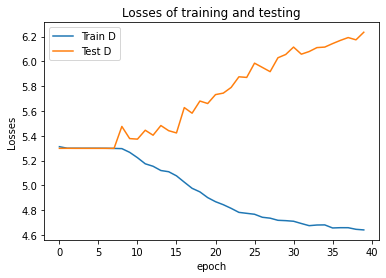

In [17]:
#plotting loss of traning and testing 
plt.plot(MLP_results.history['loss'])
plt.plot(MLP_results.history['val_loss'])
plt.legend(['Train D', 'Test D'])
plt.title('Losses of training and testing')
plt.xlabel('epoch')
plt.ylabel('Losses')

Text(0, 0.5, 'accuracy')

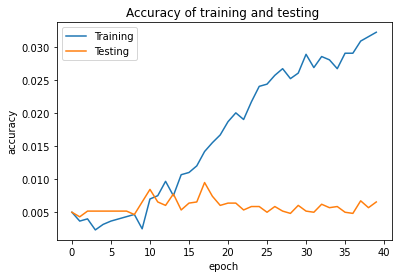

In [18]:
#plotting accuracy for traning and testing 
plt.plot(MLP_results.history['accuracy'])
plt.plot(MLP_results.history['val_accuracy'])
plt.legend(['Training', 'Testing'])
plt.title('Accuracy of training and testing ')
plt.xlabel('epoch')
plt.ylabel('accuracy')

### Provide your discussion

I resize data and reshape it to give for the multi-layer perceptron and  try the model more than one time with different activation functions and and diffrant epochs and batch size but don’t affect so much 

as we see in the graph the model overfit he could classify trained image by accuracy good and loss decreased but in the testing the accuracy low, the model not classify correct images and to be more generalized and more update in his wait and give more data in every class to could learn and change in number of layer and activation function and number of neorons


## Part 2. VGG-16 (4 Marks)

For this section you will adapt the VGG-16 network for the current task using tranfer learning and fine-tuning. You will implement the following in your process:
- You should choose a suitable image size.
- Choose a suitable labelling scheme.
- Use the pretrained VGG16 network available in Keras.
- Remove the top fully connected layers. Include your own FC layers that match our dataset.
- Choose some layers to "freeze" and the remaining layers you will fine-tune with the new dataset.

### Step 1
You will use the above steps to train a VGG-16 model using the Bird dataset
- Use transfer learning to train your first model by removing the FC layers, but leaving the other layers intact.
- Plot a loss curve for training and test data
- Plot an accuracy curve for training and test data

### Step 2
Now use the same steps as above, but this time unfreeze some convolutional layers and retrain the network. Again, plot your results.

### Step 3
Discuss the results of both methods from step 1 and step 2 while using plots and graphics to support your discussion.


In [19]:
#Write your VGG code here

from keras import layers, models
from  keras.models import Model
from tensorflow.keras.applications import VGG16
from keras.applications.vgg16 import preprocess_input

### build VGG16 model and retrain fully connected layer 

In [20]:
#Write your VGG code here

x_vgg_train,y_train ,x_vgg_test,y_test = resize_images(train_data ,test_data ,(64, 64))
y_tr_categ = to_categorical(y_train,200)
y_te_categ = to_categorical(y_test,200)

input_shape=(x_vgg_train.shape[1], x_vgg_train.shape[2], x_vgg_train.shape[3])
VGG_model = VGG16(weights="imagenet", include_top=False, input_shape=input_shape)
VGG_model.summary()


58900480/58889256 [==============================] - 3s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 32, 32, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 32, 32, 128)       147584    
                                                              

### Add new fully connected output layer 

In [23]:
# make trainable layer flase to don't intialize it 
for layer in VGG_model.layers:
    layer.trainable = False

# last layers output
out = VGG_model.layers[-1].output
# Flatten as before
out = Flatten()(out)
# add layers 
out = Dense(500, activation='relu')(out)
out = Dense(512, activation='relu')(out)
out = Dense(400, activation='relu')(out)
out = Dense(200, activation='softmax')(out)
# build new model 
VGG_model_transfer = Model(inputs=VGG_model.input, outputs=out)
VGG_model_transfer.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 32, 32, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 32, 32, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 16, 16, 128)       0   

In [24]:
VGG_model_transfer.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)
batch_size = 128
epoch = 16 

vgg16_results=VGG_model_transfer.fit(x_vgg_train, y_tr_categ ,batch_size=batch_size, epochs=epoch, validation_data=(x_vgg_test , y_te_categ))


Epoch 1/16
47/47 [==============================] - 439s 9s/step - loss: 5.2229 - accuracy: 0.0088 - val_loss: 5.4840 - val_accuracy: 0.0088
Epoch 2/16
47/47 [==============================] - 472s 10s/step - loss: 4.7649 - accuracy: 0.0316 - val_loss: 5.9275 - val_accuracy: 0.0071
Epoch 3/16
47/47 [==============================] - 493s 11s/step - loss: 4.4410 - accuracy: 0.0663 - val_loss: 6.0456 - val_accuracy: 0.0112
Epoch 4/16
47/47 [==============================] - 446s 10s/step - loss: 4.1059 - accuracy: 0.0982 - val_loss: 6.3245 - val_accuracy: 0.0097
Epoch 5/16
47/47 [==============================] - 423s 9s/step - loss: 3.7867 - accuracy: 0.1521 - val_loss: 6.6652 - val_accuracy: 0.0109
Epoch 6/16
47/47 [==============================] - 445s 10s/step - loss: 3.4587 - accuracy: 0.1893 - val_loss: 7.2214 - val_accuracy: 0.0104
Epoch 7/16
47/47 [==============================] - 436s 9s/step - loss: 3.1137 - accuracy: 0.2548 - val_loss: 7.5583 - val_accuracy: 0.0093
Epoch 8/1

In [25]:
test_SC_vgg = VGG_model_transfer.evaluate(x_vgg_test, y_te_categ,verbose=1)
print('Loss for testing:', test_SC_vgg[0])
print('Accuracy for testing :', test_SC_vgg[1])
#vgg16_results

181/181 [==============================] - 241s 1s/step - loss: 13.2651 - accuracy: 0.0131
Loss for testing: 13.265110969543457
Accuracy for testing : 0.013126078993082047


### plot result 

Text(0, 0.5, 'Losses')

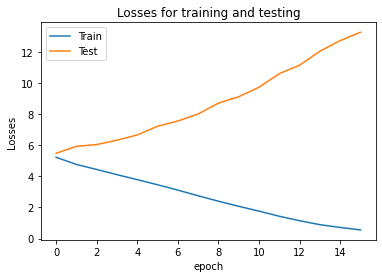

In [30]:
#plotting loss of traning and testing 
plt.plot(vgg16_results.history['loss'])
plt.plot(vgg16_results.history['val_loss'])
plt.legend(['Train', 'Test'])
plt.title('Losses for training and testing')
plt.xlabel('epoch')
plt.ylabel('Losses')

Text(0, 0.5, 'accuracy')

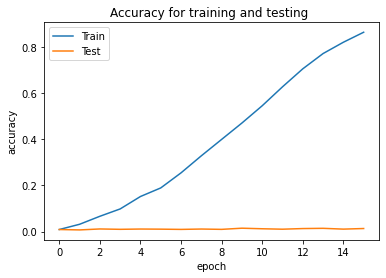

In [31]:
#plotting accuracy for traning and testing 
plt.plot(vgg16_results.history['accuracy'])
plt.plot(vgg16_results.history['val_accuracy'])
plt.legend(['Train', 'Test '])
plt.title('Accuracy for training and testing ')
plt.xlabel('epoch')
plt.ylabel('accuracy')

### Step 2

Now use the same steps as above, but this time unfreeze some convolutional layers and retrain the network. Again, plot your results.


### step 2

In [9]:
# get a sample from each class in train and in test data 
d_train =[]
a = np.array(train_data['y'])
index ={}
for i in range(200):
  index[i] = np.where(a ==i)[0]
  for j in range(10):
    x =train_data['x'][index[i][j]]
    y = train_data['y'][index[i][j]]
    d_train.append([x,y])
d_test =[]
a = np.array(test_data['y'])
index ={}
for i in range(200):
  index[i] = np.where(a ==i)[0]
  for j in range(10):
    x =train_data['x'][index[i][j]]
    y = train_data['y'][index[i][j]]
    d_test.append([x,y])
         


In [10]:
sample_train = pd.DataFrame(d_train, columns = ['x', 'y'])
sample_test = pd.DataFrame(d_test, columns = ['x', 'y'])
# call resize images 
train_x_vgg,y_train ,test_x_vgg,y_test = resize_images(sample_train,sample_test ,(64, 64))
# get calegorical labels 
y_tr_categ = to_categorical(y_train,200)
y_te_categ = to_categorical(y_test,200)
y_tr_categ.shape

(1997, 200)

In [11]:
## Loading VGG16 model
input_shape=(train_x_vgg.shape[1], train_x_vgg.shape[2], train_x_vgg.shape[3])

VGG_fullConnect = VGG16(
    weights="imagenet",  
    include_top=False, 
    input_shape =input_shape )


In [12]:
for layers in (VGG_fullConnect.layers[7:11]):
    layers.trainable = False
for layer in VGG_fullConnect.layers:
    print(layer.name ,layer.trainable)
VGG_fullConnect.summary()

input_1 True
block1_conv1 True
block1_conv2 True
block1_pool True
block2_conv1 True
block2_conv2 True
block2_pool True
block3_conv1 False
block3_conv2 False
block3_conv3 False
block3_pool False
block4_conv1 True
block4_conv2 True
block4_conv3 True
block4_pool True
block5_conv1 True
block5_conv2 True
block5_conv3 True
block5_pool True
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                       

In [13]:

X= VGG_fullConnect.layers[-1].output
X = Flatten()(X)

X = Dense(512, activation='relu')(X)
X = Dense(512, activation='relu')(X)
out = Dense(200, activation="softmax")(X)
VGG_modified_model = Model(inputs = VGG_fullConnect.input, outputs = out)
VGG_modified_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 32, 32, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 32, 32, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 16, 16, 128)       0     

In [14]:

VGG_modified_model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)
batch_size = 128
epoch = 6 

vgg16_results=VGG_modified_model.fit(
    train_x_vgg, 
    y_tr_categ ,
    batch_size=batch_size, 
    epochs=epoch, 
    validation_data=(test_x_vgg, y_te_categ))


Epoch 1/6
16/16 [==============================] - 26s 818ms/step - loss: 5.3425 - accuracy: 0.0050 - val_loss: 5.2984 - val_accuracy: 0.0050
Epoch 2/6
16/16 [==============================] - 6s 374ms/step - loss: 5.3008 - accuracy: 0.0040 - val_loss: 5.2985 - val_accuracy: 0.0055
Epoch 3/6
16/16 [==============================] - 7s 438ms/step - loss: 5.2989 - accuracy: 0.0060 - val_loss: 5.2983 - val_accuracy: 0.0050
Epoch 4/6
16/16 [==============================] - 6s 369ms/step - loss: 5.2987 - accuracy: 0.0045 - val_loss: 5.2983 - val_accuracy: 0.0050
Epoch 5/6
16/16 [==============================] - 6s 368ms/step - loss: 5.2987 - accuracy: 0.0050 - val_loss: 5.2983 - val_accuracy: 0.0050
Epoch 6/6
16/16 [==============================] - 6s 369ms/step - loss: 5.2987 - accuracy: 0.0025 - val_loss: 5.2983 - val_accuracy: 0.0050


In [15]:
results = VGG_modified_model.evaluate(test_x_vgg, y_te_categ ,verbose=1)
print('Loss for testing:', results[0])
print('Accuracy for testing :', results[1])

63/63 [==============================] - 4s 45ms/step - loss: 5.2983 - accuracy: 0.0050
Loss for testing: 5.2983245849609375
Accuracy for testing : 0.005005004815757275


Text(0, 0.5, 'Losses')

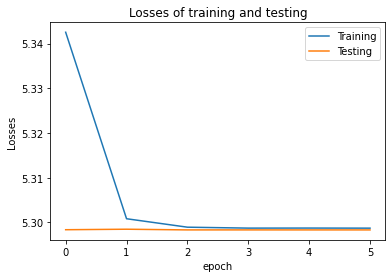

In [16]:
#plotting loss of traning and testing 
plt.plot(vgg16_results.history['loss'])
plt.plot(vgg16_results.history['val_loss'])
plt.legend(['Training', 'Testing'])
plt.title('Losses of training and testing')
plt.xlabel('epoch')
plt.ylabel('Losses')

Text(0, 0.5, 'accuracy')

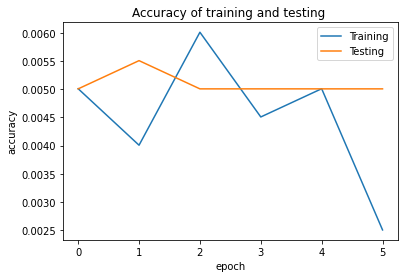

In [17]:
#plotting accuracy for traning and testing 
plt.plot(vgg16_results.history['accuracy'])
plt.plot(vgg16_results.history['val_accuracy'])
plt.legend(['Training', 'Testing'])
plt.title('Accuracy of training and testing ')
plt.xlabel('epoch')
plt.ylabel('accuracy')

### step 3 discution


- step 1: 

step 1 I give the model the same  with double size of perceptron and train the model and validate it sometimes the model improves inaccuracy  in the training and give me more than 90%  but in testing give 1% this is overfitting but the last time I run the model give underfitting  and the model can’t learn this because the initialization of the model when training it on data not enough and need more data when trying different activation function effect inaccuracy


- step 2 : 

get a sample from each class in train and in test data and convert labels to categorical list to could train model in an increased dimension of images and convert labels to the categorical list because the model predict binary and we learn to use the pre-trained model to transfer learning .change the pre-trained weights and get the results but when the change in the VGG16 returned layer the accuracy decreased and model don’t learn and become underfitting and don’t classify images to there correct class as we see in the accuracy graph the loss function decreased in train data but not decreased so much so the model becomes underfitting and need more data to train it on it and to change the activation function and learn_rate a change,the number of neurons for each layer. I freeze 4 layers from convolutional network and make it get random initialization in the training with my layer  but the accuracy and deceased and loss increase 

## Part 3. Visualization (3 Marks)

For this section you will visualize the filters learned byyour VGG-16 network and use t-SNE to observe clusters that were learned by your model.
- Make sure to provide the graphic results for your visualizations
- Provide an interpretation of the results

## Bonus (1 Mark)
Visualize the activation maps produced by your network and discuss the results using an image from the test test and another image of your choice.

In [18]:
# Write your visualization code here.
from PIL import Image
from sklearn.manifold import TSNE


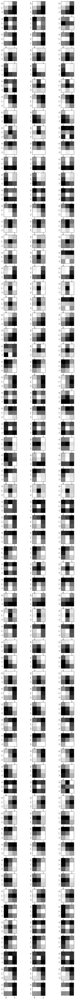

In [19]:

# retrieve weights from the second hidden layer
filter_layer1, biases = VGG_modified_model.layers[1].get_weights()
# normalize filter values to 0-1 
f_min, f_max = filter_layer1.min(), filter_layer1.max()
filter_layer1 = (filter_layer1 - f_min) / (f_max - f_min)
#get the number of filter in layer 
num_filters = filter_layer1.shape[3]

fig , ax = plt.subplots(num_filters, 3 ,figsize=(8,100))
a = np.array(y)
for i in range(num_filters):
    f = filter_layer1[:, :, :, i]
    # plot each channel separately
    for j in range(3):
        plt.axis("off")
        ax[i,j].imshow(f[:, :, j],cmap='gray')


#### draw sample of filters of weight from evry layer

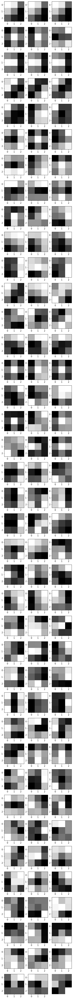

In [20]:
#get the lenth of convlutional layer 
lenth = 0
for i in range(1,len(VGG_modified_model.layers)):
  if 'con' in VGG_modified_model.layers[i].name:
    lenth +=1

n_filters = 3*lenth
# create figer and  subblot
fig , ax = plt.subplots(n_filters, 3 ,figsize=(6,90))
row = -1
for c in range(1,len(VGG_modified_model.layers)):
    if 'con' in VGG_modified_model.layers[c].name:
        filter, biases = VGG_modified_model.layers[c].get_weights()
        # normalize filter values to 0-1 
        f_min, f_max = filter.min(), filter.max()
        filter = (filter - f_min) / (f_max - f_min)
        #get the number of filter in layer 
        for i in range(3):
          # increase counter of row to drow images 
          row +=1
          f = filter[:, :, :, i]
          # plot each channel separately
          for j in range(3):
              plt.axis("off")
              ax[row,j].imshow(f[:, :, j],cmap='gray')

In [33]:
model_features = VGG_modified_model.predict(test_x_vgg)
#model = Model(inputs=VGG_modified_model.input,outputs=VGG_modified_model.get_layer('dense').output) 
#model_features = model.predict(test_x_vgg)

# fit the Tsne in the feature come from prediction of model 
tsne = TSNE().fit_transform(model_features)
tx, ty = tsne[:,0], tsne[:,1]
tx = (tx-np.min(tx)) / (np.max(tx) - np.min(tx))
ty = (ty-np.min(ty)) / (np.max(ty) - np.min(ty))
width = 4000
height = 3000
max_dim = 100
full_image = Image.new('RGB', (width, height))
for idx, x in enumerate(test_x_vgg):
    tile = Image.fromarray(np.uint8(x * 255))
    rs = max(1, tile.width / max_dim, tile.height / max_dim)
    tile = tile.resize((int(tile.width / rs),
                        int(tile.height / rs)),
                       Image.ANTIALIAS)
    full_image.paste(tile, (int((width-max_dim) * tx[idx]),
                            int((height-max_dim) * ty[idx])))

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


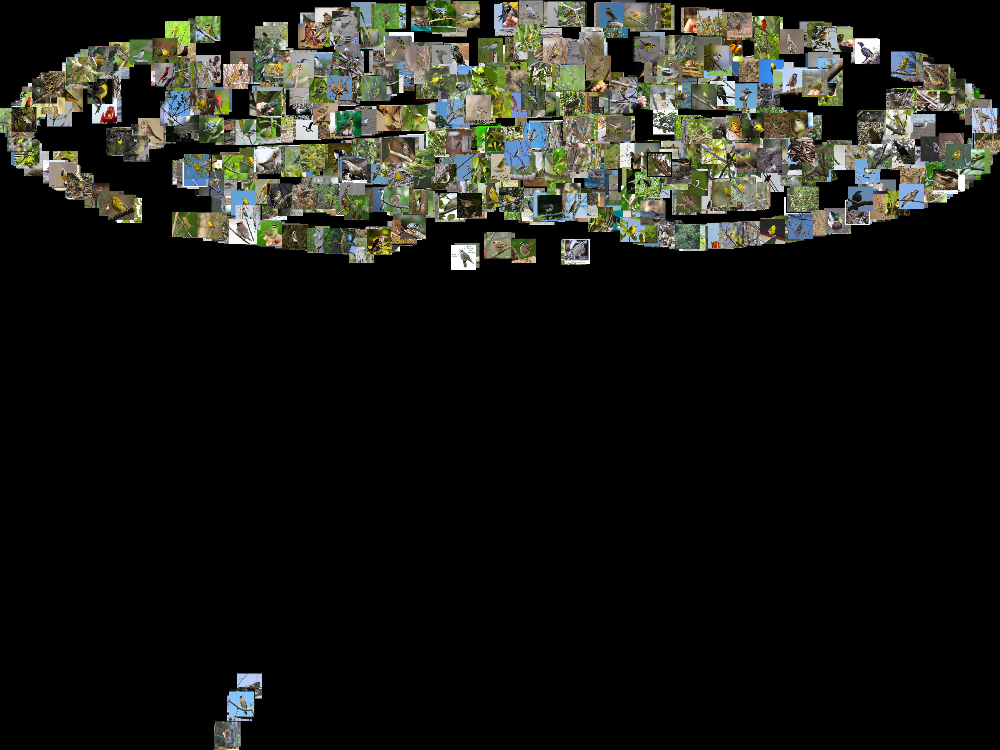

In [ ]:
full_image

Discuss here.

The summary function gives us the size of the filter and the number of filters in each layer but does not give information. when visualizing this filter as the image gives information about the values for it and the weights that affect in activation function and as we see in the result the filters sometimes are the same in the 3 and sometimes are different we access all layers by name of the model make normalization and plot every channel in every layer. to get more visualization about results of the model we make a prediction to test data and the feature that com prediction I use Tsne to make dimensionality reduction and cane plot images instead of point and see the prediction results but the accuracy of the model not good and make underfitting and not classify correct and not group image correct 


## Bonus (1 Mark)
Visualize the activation maps produced by your network and discuss the results using an image from the test test and another image of your choice.

In [86]:

# load the model
model = VGG16(weights="imagenet")
# redefine model input and output
model = Model(inputs=model.inputs, outputs=model.layers[1].output)
model.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
Total params: 1,792
Trainable params: 1,792
Non-trainable params: 0
_________________________________________________________________


In [97]:
image1 =test_data['x'][1000]
image1 = tf.image.resize(image1, (224, 224), method='nearest')
image1 =image1.numpy()/255.0
image2 =imread('bird.jpg')      
image2 =tf.image.resize(image2, (224, 224), method='nearest')   
image2 =image2.numpy()/255.0
mg1 = np.expand_dims(image1, axis=0)
mg2 = np.expand_dims(image2, axis=0)

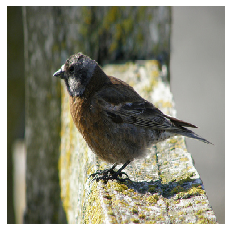

In [98]:
plot_image(image1)

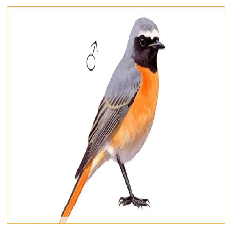

In [80]:
plot_image(image2)

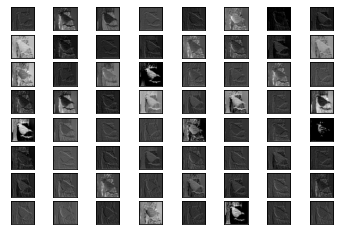

In [99]:
# get feature map for first hidden layer
feature_maps = model.predict(mg1)
# plot all 64 maps in an 8x8 squares
square = 8
ix = 1
for _ in range(square):
	for _ in range(square):
		# specify subplot and turn of axis
		ax = plt.subplot(square, square, ix)
		ax.set_xticks([])
		ax.set_yticks([])
		# plot filter channel in grayscale
		plt.imshow(feature_maps[0, :, :, ix-1], cmap='gray')
		ix += 1
# show the figure
plt.show()

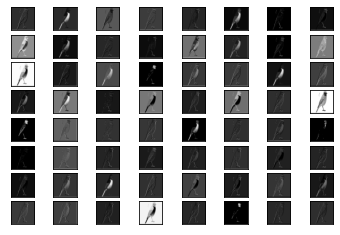

In [103]:
# get feature map for first hidden layer
feature_maps = model.predict(mg2)
# plot all 64 maps in an 8x8 squares
square = 8
ix = 1
for _ in range(square):
	for _ in range(square):
		# specify subplot and turn of axis
		ax = plt.subplot(square, square, ix)
		ax.set_xticks([])
		ax.set_yticks([])
		# plot filter channel in grayscale
		plt.imshow(feature_maps[0, :, :, ix-1], cmap='gray')
		ix += 1
# show the figure
plt.show()

In [104]:
feature_maps.shape

(1, 224, 224, 64)

For the buns step, I upload an image and read the image from the testing image and give to the model and predict it and plot all the filters. The activation map get the result after applying some filter on input or the output from other layer and as we see in the image from test data this result is not a clear image and the image I upload  give more features and more clear  the this helps us to understand the feature and give more detailed 